# Tourism destinations recommendation system



In [42]:
import pandas as pd
print("Hello")
!python3 --version


Hello
Python 3.11.3


# Load dataset



In [44]:
DATAPATH = './data/Testing.csv' 

df = pd.read_csv(DATAPATH,encoding="utf-8", sep=",")
# df = df[~df.overview.isna()]
df.rename(columns={'description':'sentence'}, inplace=True)
print(len(df))
df = df.iloc[:20000]
df

27


,city,lat,lng,country,iso2,admin_name,capital,population,population_proper,sentence,...,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,url
0,Peshawar,34.0000,71.5000,Pakistan,PK,Khyber Pakhtunkhwa,admin,1970042.0,1970042.0,known for the historical places very old and very beautful city of flowers,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/Peshawar.jpg
1,Saidu Sharif,34.7500,72.3572,Pakistan,PK,Khyber Pakhtunkhwa,minor,1860310.0,1860310.0,many tombs in this place,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/saidu-sharif.jpg
2,Mardan,34.1958,72.0447,Pakistan,PK,Khyber Pakhtunkhwa,minor,300424.0,300424.0,"The district is famous for its agriculture industry, Peerah the famous sooghaat of mardan and for its archaeological sites of Takht-i-Bhai, Jamal Garhi and Sawal Dher.",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/Mardan.jpg
3,Mingaora,34.7717,72.3600,Pakistan,PK,Khyber Pakhtunkhwa,NaN,279914.0,279914.0,Buddhist remains and carvings have been discovered near Mingora in the Jambil River Valley.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/Mingaora.jpg
4,Kohat,33.5869,71.4414,Pakistan,PK,Khyber Pakhtunkhwa,minor,170800.0,170800.0,"Kohat is known for crops, vegetables and fruits like wheat, barley, onions, guava, pomegranate and persimmons. Guava is the major fruit of Kohat and is famous for its quality and taste. The mouthwatering Chapli Kabab is the favorite cuisine of people living in Kohat as well as the outsiders coming to visit Kohat.",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/kohat.jpg
5,Abbottabad,34.1500,73.2167,Pakistan,PK,Khyber Pakhtunkhwa,minor,148587.0,148587.0,"It is a popular summer resort, located at the end of Murree-Abbottabad hill tract, noted for its verdant parks, gardens, golf course and pine covered hills. Major Bazars of the area include Sarban chowk, Ghaniadda bazar, and Cantt plaza. Abbottabad is blessed with many natural resources.",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/Abbottabad.jpg
6,Nowshera,34.0153,71.9747,Pakistan,PK,Khyber Pakhtunkhwa,minor,118594.0,118594.0,The shrine of 16th century's most popular Sufi saint Sayyid Kastir Gul alias Hazrat Kaka Sahib is located in a rugged mountainous area around 12 km south of Nowshera district. It is considered one of the most frequently visited religious heritage sites in Khyber Pakhtunkhwa.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/Nowshera.jpg
7,Swabi,34.1167,72.4667,Pakistan,PK,Khyber Pakhtunkhwa,minor,115018.0,115018.0,"The people of Swabi are very hospitable,brave and hardworking,many legend belong to District Swabi.It is one the most Hostorical and Archaeological land in the World.",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/Swabi.jpg
8,Dera Ismail Khan,31.8167,70.9167,Pakistan,PK,Khyber Pakhtunkhwa,minor,109686.0,109686.0,Dera Ismail Khan is also famous for a desert delicacy called sohan halwa. The shops of this delicacy are mostly situated in Topawaala bazar. Dates are grown here in abundance and are one of the major exports.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/Dera Ismail Khan.jpg
9,Charsadda,34.1453,71.7308,Pakistan,PK,Khyber Pakhtunkhwa,minor,105414.0,105414.0,"The city is famous for Shoes making, Khaddar and Agriculture.",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images/Charsadda.jpg


In [3]:
!pip3 install nltk
import nltk
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt')


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\aa\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aa\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\aa\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [46]:
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import re

STOPWORDS = set(stopwords.words('english'))
MIN_WORDS = 4
MAX_WORDS = 200

PATTERN_S = re.compile("\'s")  # matches `'s` from text  
PATTERN_RN = re.compile("\\r\\n") #matches `\r` and `\n`
PATTERN_PUNC = re.compile(r"[^\w\s]") # matches all non 0-9 A-z whitespace 


def clean_text(text):
    """
    Series of cleaning. String to lower case, remove non words characters and numbers.
        text (str): input text
    return (str): modified initial text
    """
    if isinstance(text, float):
        # If text is a float, return an empty string
        return ''
    text = text.lower()  # lowercase text
    text = re.sub(PATTERN_S, ' ', text)
    text = re.sub(PATTERN_RN, ' ', text)
    text = re.sub(PATTERN_PUNC, ' ', text)
    
    return text

def tokenizer(sentence, min_words=MIN_WORDS, max_words=MAX_WORDS, stopwords=STOPWORDS, lemmatize=True):
    """
    Lemmatize, tokenize, crop and remove stop words.
    """
    if lemmatize:
        stemmer = WordNetLemmatizer()
        tokens = [stemmer.lemmatize(w) for w in word_tokenize(sentence)]
    else:
        tokens = [w for w in word_tokenize(sentence)]
    token = [w for w in tokens if (len(w) > min_words and len(w) < max_words
                                                        and w not in stopwords)]
    return tokens    


def clean_sentences(df):
    """
    Remove irrelavant characters (in new column clean_sentence).
    Lemmatize, tokenize words into list of words (in new column tok_lem_sentence).
    """
    print('Cleaning sentences...')
    df['clean_sentence'] = df['sentence'].apply(clean_text)
    df['tok_lem_sentence'] = df['clean_sentence'].apply(
        lambda x: tokenizer(x, min_words=MIN_WORDS, max_words=MAX_WORDS, stopwords=STOPWORDS, lemmatize=True))
    return df
    
df = clean_sentences(df)

Cleaning sentences...


In [47]:
print(len(df))
df[['sentence', 'clean_sentence', 'tok_lem_sentence']]

27


,sentence,clean_sentence,tok_lem_sentence
0,known for the historical places very old and very beautful city of flowers,known for the historical places very old and very beautful city of flowers,"[known, for, the, historical, place, very, old, and, very, beautful, city, of, flower]"
1,many tombs in this place,many tombs in this place,"[many, tomb, in, this, place]"
2,"The district is famous for its agriculture industry, Peerah the famous sooghaat of mardan and for its archaeological sites of Takht-i-Bhai, Jamal Garhi and Sawal Dher.",the district is famous for its agriculture industry peerah the famous sooghaat of mardan and for its archaeological sites of takht i bhai jamal garhi and sawal dher,"[the, district, is, famous, for, it, agriculture, industry, peerah, the, famous, sooghaat, of, mardan, and, for, it, archaeological, site, of, takht, i, bhai, jamal, garhi, and, sawal, dher]"
3,Buddhist remains and carvings have been discovered near Mingora in the Jambil River Valley.,buddhist remains and carvings have been discovered near mingora in the jambil river valley,"[buddhist, remains, and, carving, have, been, discovered, near, mingora, in, the, jambil, river, valley]"
4,"Kohat is known for crops, vegetables and fruits like wheat, barley, onions, guava, pomegranate and persimmons. Guava is the major fruit of Kohat and is famous for its quality and taste. The mouthwatering Chapli Kabab is the favorite cuisine of people living in Kohat as well as the outsiders coming to visit Kohat.",kohat is known for crops vegetables and fruits like wheat barley onions guava pomegranate and persimmons guava is the major fruit of kohat and is famous for its quality and taste the mouthwatering chapli kabab is the favorite cuisine of people living in kohat as well as the outsiders coming to visit kohat,"[kohat, is, known, for, crop, vegetable, and, fruit, like, wheat, barley, onion, guava, pomegranate, and, persimmon, guava, is, the, major, fruit, of, kohat, and, is, famous, for, it, quality, and, taste, the, mouthwatering, chapli, kabab, is, the, favorite, cuisine, of, people, living, in, kohat, a, well, a, the, outsider, coming, to, visit, kohat]"
5,"It is a popular summer resort, located at the end of Murree-Abbottabad hill tract, noted for its verdant parks, gardens, golf course and pine covered hills. Major Bazars of the area include Sarban chowk, Ghaniadda bazar, and Cantt plaza. Abbottabad is blessed with many natural resources.",it is a popular summer resort located at the end of murree abbottabad hill tract noted for its verdant parks gardens golf course and pine covered hills major bazars of the area include sarban chowk ghaniadda bazar and cantt plaza abbottabad is blessed with many natural resources,"[it, is, a, popular, summer, resort, located, at, the, end, of, murree, abbottabad, hill, tract, noted, for, it, verdant, park, garden, golf, course, and, pine, covered, hill, major, bazar, of, the, area, include, sarban, chowk, ghaniadda, bazar, and, cantt, plaza, abbottabad, is, blessed, with, many, natural, resource]"
6,The shrine of 16th century's most popular Sufi saint Sayyid Kastir Gul alias Hazrat Kaka Sahib is located in a rugged mountainous area around 12 km south of Nowshera district. It is considered one of the most frequently visited religious heritage sites in Khyber Pakhtunkhwa.,the shrine of 16th century most popular sufi saint sayyid kastir gul alias hazrat kaka sahib is located in a rugged mountainous area around 12 km south of nowshera district it is considered one of the most frequently visited religious heritage sites in khyber pakhtunkhwa,"[the, shrine, of, 16th, century, most, popular, sufi, saint, sayyid, kastir, gul, alias, hazrat, kaka, sahib, is, located, in, a, rugged, mountainous, area, around, 12, km, south, of, nowshera, district, it, is, considered, one, of, the, most, frequently, visited, religious, heritage, site, in, khyber, pakhtunkhwa]"
7,"The people of Swabi are very hospitable,brave and hardworking,

## Query sentence

In [48]:
query_sentence = 'often snowfall beautiful mountains' 

pd.options.display.max_colwidth = 500

## Util function

In [49]:
def extract_best_indices(m, topk, mask=None):
    """
    Use sum of the cosine distance over all tokens.
    m (np.array): cos matrix of shape (nb_in_tokens, nb_dict_tokens)
    topk (int): number of indices to return (from high to lowest in order)
    """
    # return the sum on all tokens of cosinus for each sentence
    if len(m.shape) > 1:
        cos_sim = np.mean(m, axis=0) 
    else: 
        cos_sim = m
    index = np.argsort(cos_sim)[::-1] # from highest idx to smallest score 
    if mask is not None:
        assert mask.shape == m.shape
        mask = mask[index]
    else:
        mask = np.ones(len(cos_sim))
    mask = np.logical_or(cos_sim[index] != 0, mask) #eliminate 0 cosine distance
    best_index = index[mask][:topk]  
    return best_index

# TF-IDF

## Training

In [50]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

# Adapt stop words
token_stop = tokenizer(' '.join(STOPWORDS), lemmatize=False)
# replace NaN values with empty string
df.fillna("", inplace=True)

# convert dataframe to a list of strings
text_data = df['sentence'].tolist()

# Fit TFIDF
vectorizer = TfidfVectorizer(stop_words=token_stop, tokenizer=tokenizer) 
tfidf_mat = vectorizer.fit_transform(df['sentence'].values) # -> (num_sentences, num_vocabulary)
tfidf_mat.shape

C:\Users\aa\anaconda3\lib\site-packages\sklearn\feature_extraction\text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['doe', 'ha', 'wa'] not in stop_words.
  warnings.warn(


(27, 415)

## Prediction

In [19]:
query_sentence

'often snowfall beautiful mountains'

In [51]:

def transform_df(df):
    df = df.to_dict()
    output_list = []

    for key, value in df['city'].items():
        description = df['sentence'][key]
        output_list.append({'city': value.lower(), 'description': description})
    
    return output_list

def get_recommendations_tfidf(sentence, tfidf_mat):
    
    """
    Return the database sentences in order of highest cosine similarity relatively to each 
    token of the target sentence. 
    """
    # Embed the query sentence
    tokens = [str(tok) for tok in tokenizer(sentence)]
    vec = vectorizer.transform(tokens)
    # Create list with similarity between query and dataset
    mat = cosine_similarity(vec, tfidf_mat)
    # Best cosine distance for each token independantly
    print(mat.shape)
    best_index = extract_best_indices(mat, topk=3)
    return best_index


best_index = get_recommendations_tfidf("thick green forest with mountains and streams of water flowing", tfidf_mat)
print(best_index)

# print(df)
res = df[["city", "sentence"]].iloc[best_index]
print(transform_df(res))
display(res)


(10, 27)
[22 10 18]
[{'city': 'batgram', 'description': 'This district is noted for its scenic mountain scenery, thick forests, fertile landsand enchanting streams. Most of the population is rural , fishing has also become a mode of earningdue to some modern scientific techniques.'}, {'city': 'mansehra', 'description': 'Mansehra District is dominated by high mountains, varying in elevation from 200 meters in the south to over 4500 meters above sea level in the north. The famous Babusar pass is situated on the north-eastern boundary of the district.'}, {'city': 'chitral', 'description': "Chitral is known for its snowfall and deadly avalanches. The road that goes towards Chitral is very dangerous as it's one of the most narrow roads in the world, and it is situated in the world's largest mountain range"}]


,city,sentence
22,Batgram,"This district is noted for its scenic mountain scenery, thick forests, fertile landsand enchanting streams. Most of the population is rural , fishing has also become a mode of earningdue to some modern scientific techniques."
10,Mansehra,"Mansehra District is dominated by high mountains, varying in elevation from 200 meters in the south to over 4500 meters above sea level in the north. The famous Babusar pass is situated on the north-eastern boundary of the district."
18,Chitral,"Chitral is known for its snowfall and deadly avalanches. The road that goes towards Chitral is very dangerous as it's one of the most narrow roads in the world, and it is situated in the world's largest mountain range"


['./data/location_images\\Aansu-Lake.JPG', './data/location_images\\Abbottabad.jpg', './data/location_images\\Alpurai.jpg', './data/location_images\\Ancient_Buddha_Statue.jpg', './data/location_images\\Babusar_Top.jpg', './data/location_images\\Balakot_Mansehra.jpg', './data/location_images\\Bala_Hisar_Fort.jpg', './data/location_images\\Bannu.jpg', './data/location_images\\Batakundi_Naran.jpg', './data/location_images\\Batgram.jpg', './data/location_images\\Bilot_Fort_Temple.jpg', './data/location_images\\Boyun_Valley.jpg', './data/location_images\\Broghil_Valley_Chitral.jpg', './data/location_images\\Buni_Zom_Chitral.jpg', './data/location_images\\Butkara_Stupa_Swat.jpg', './data/location_images\\Charsadda.jpg', './data/location_images\\ChitiBoui_Glacier.jpg', './data/location_images\\Chitral.jpg', './data/location_images\\Chitral_Gol_National_Park.jpg', './data/location_images\\Daggar.jpg', './data/location_images\\DARAAL_LAKE,_Swat_valley.jpg', './data/location_images\\DARAAL_LAKE_

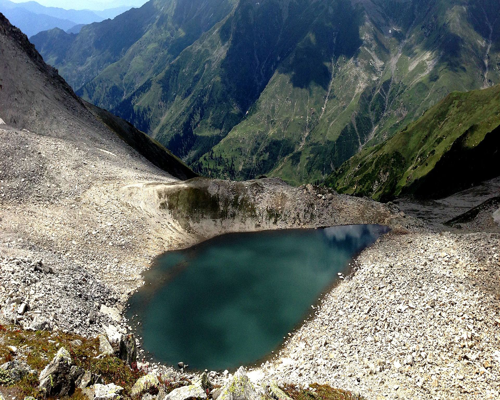

Location Name: Aansu-Lake



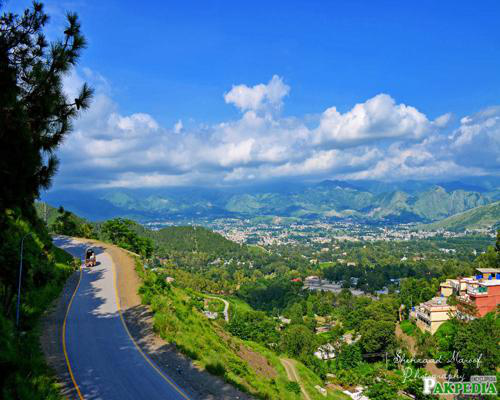

Location Name: Abbottabad



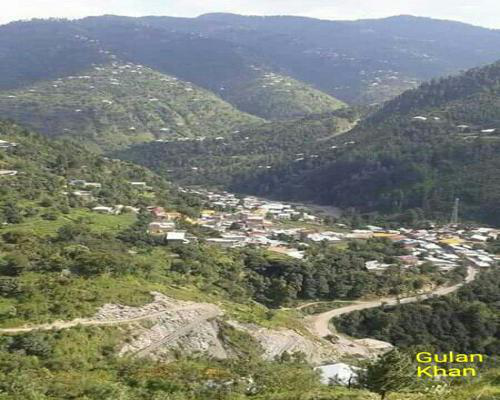

Location Name: Alpurai



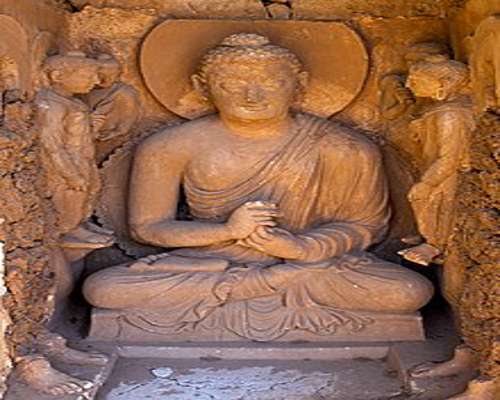

Location Name: Ancient_Buddha_Statue



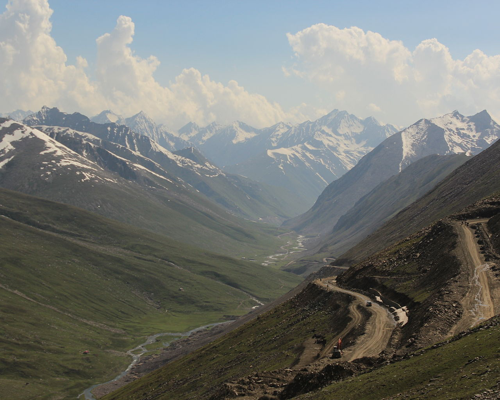

Location Name: Babusar_Top



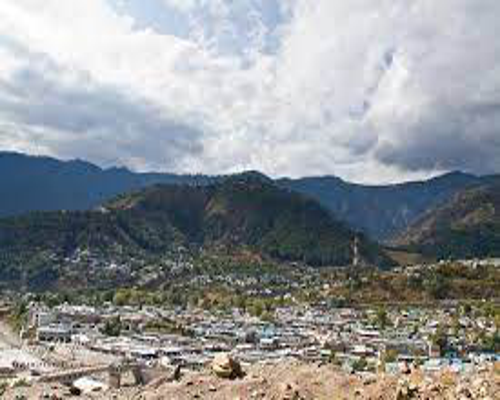

Location Name: Balakot_Mansehra



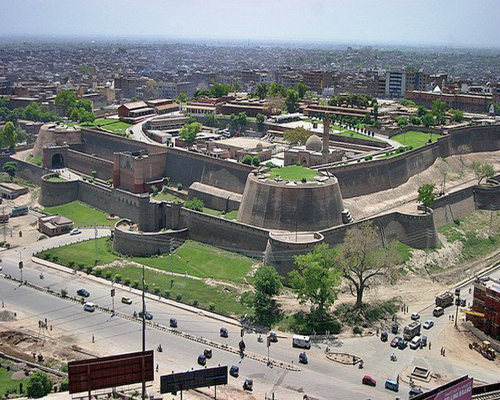

Location Name: Bala_Hisar_Fort



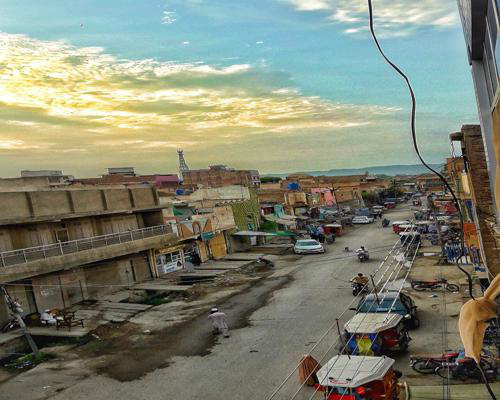

Location Name: Bannu



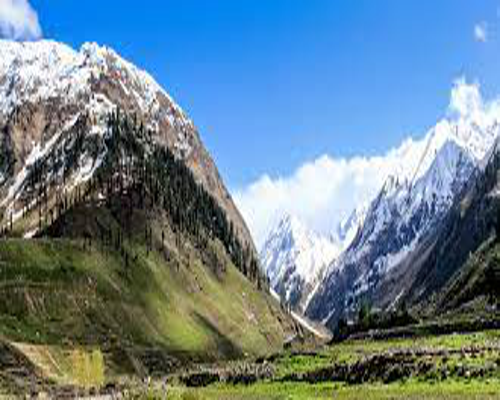

Location Name: Batakundi_Naran



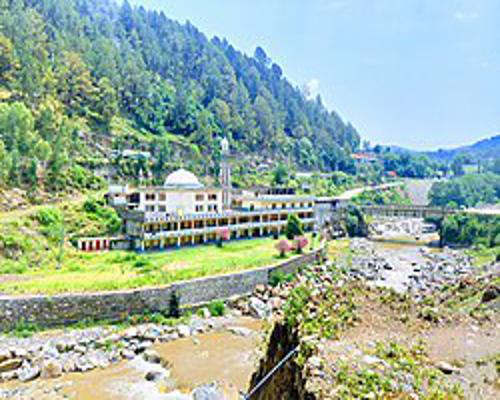

Location Name: Batgram



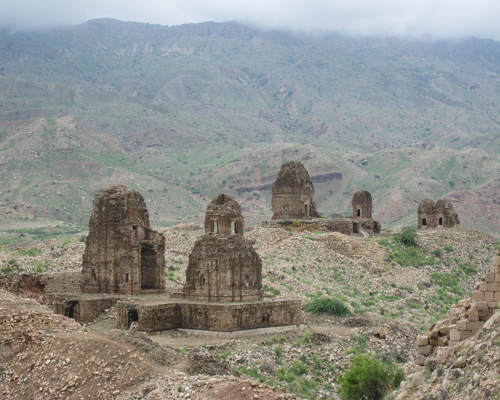

Location Name: Bilot_Fort_Temple



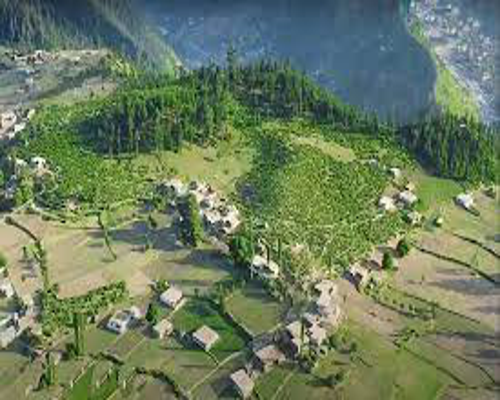

Location Name: Boyun_Valley



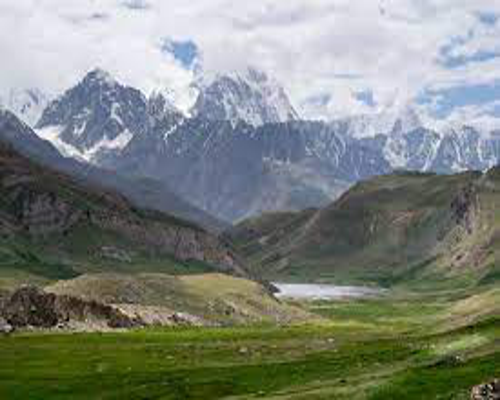

Location Name: Broghil_Valley_Chitral



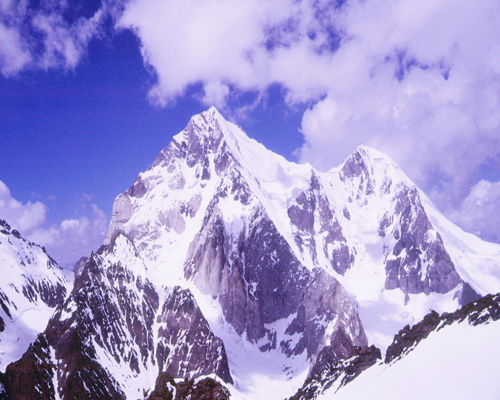

Location Name: Buni_Zom_Chitral



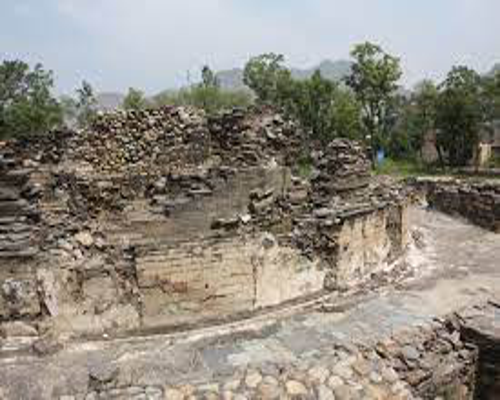

Location Name: Butkara_Stupa_Swat



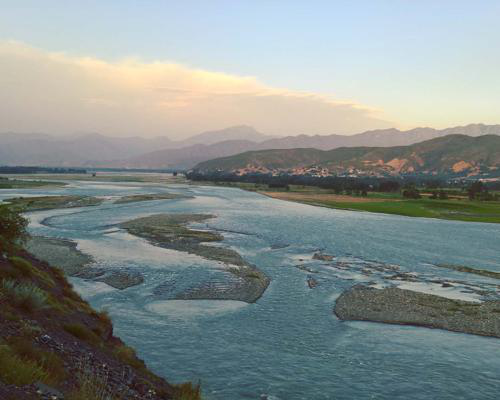

Location Name: Charsadda



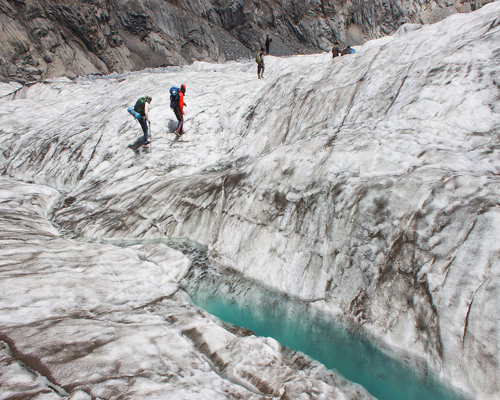

Location Name: ChitiBoui_Glacier



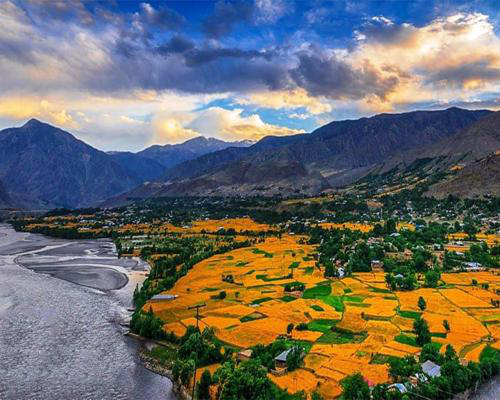

Location Name: Chitral



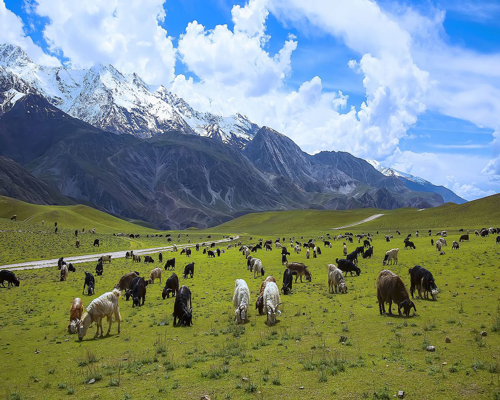

Location Name: Chitral_Gol_National_Park



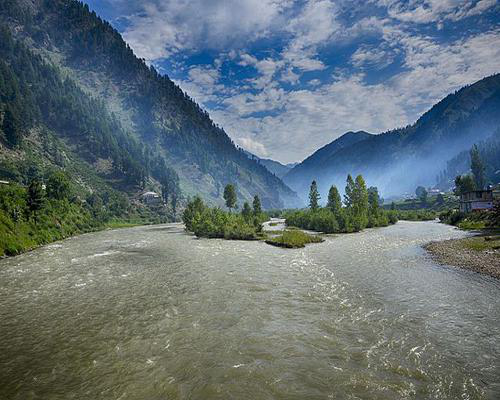

Location Name: Daggar



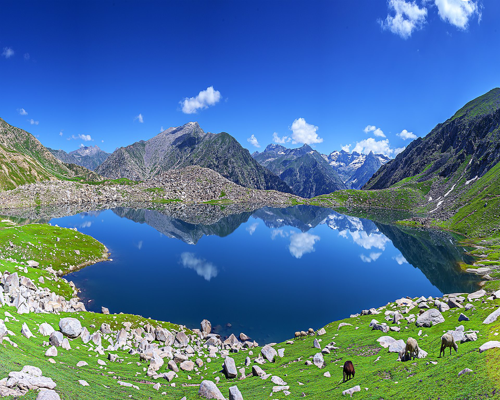

Location Name: DARAAL_LAKE,_Swat_valley



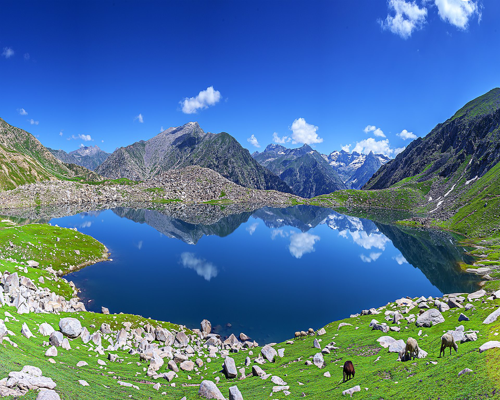

Location Name: DARAAL_LAKE_Swat_valley



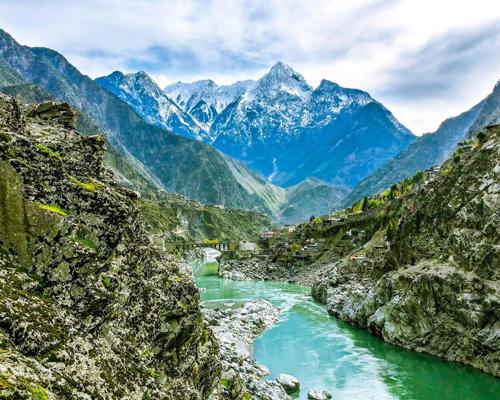

Location Name: Dasu



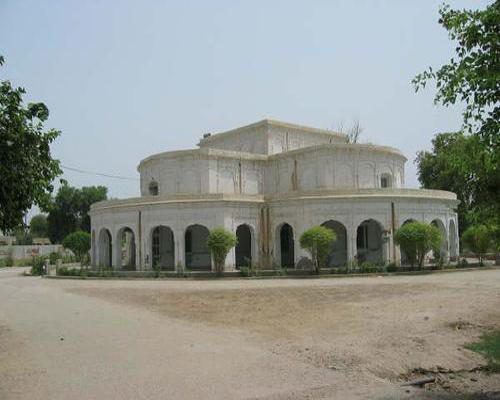

Location Name: Dera Ismail Khan



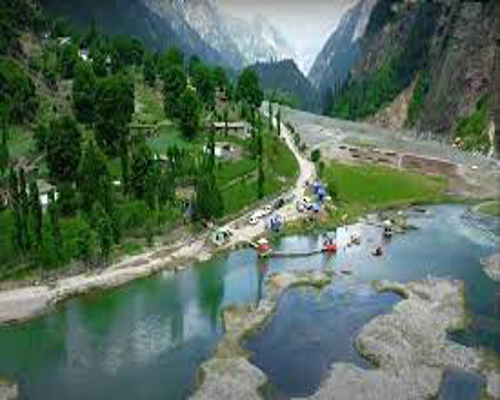

Location Name: Dhamaka_Lake Utror_Valley



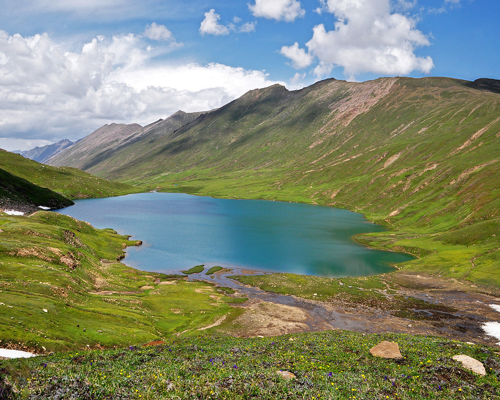

Location Name: Dudipatsar_Lake



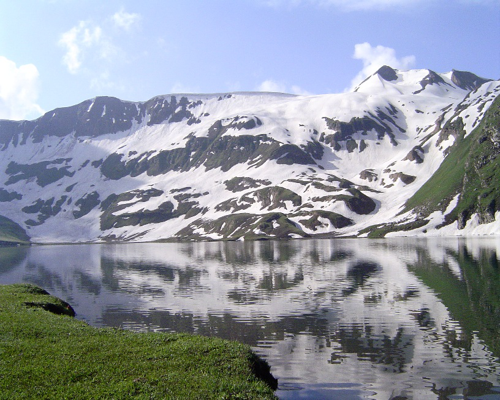

Location Name: Dudipat_lake



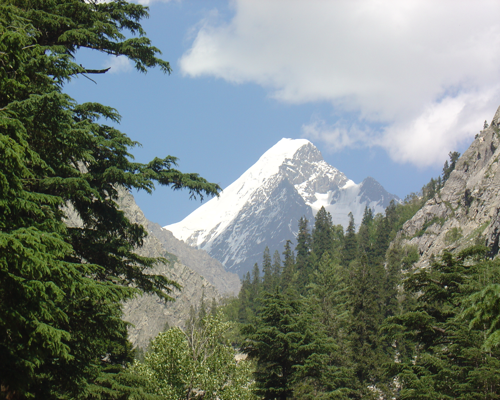

Location Name: Falak_Sher



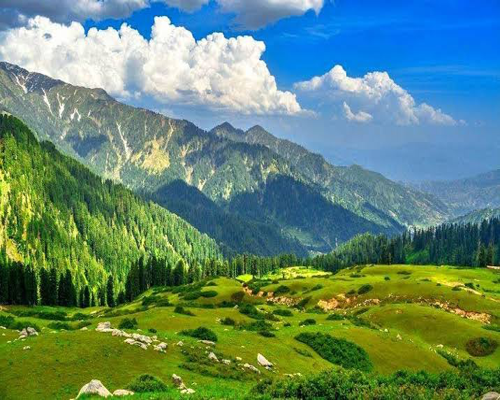

Location Name: Gabin-Jabba-swat



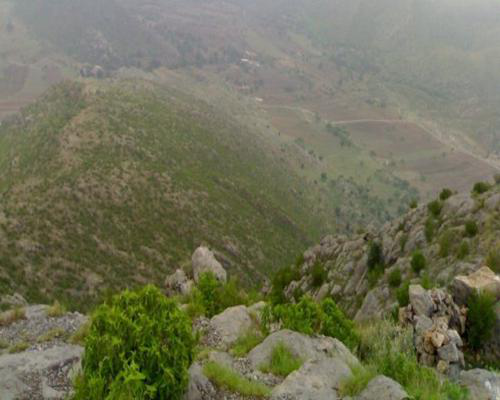

Location Name: Hangu



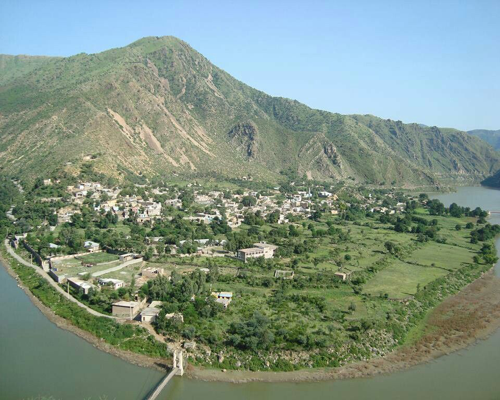

Location Name: Haripur



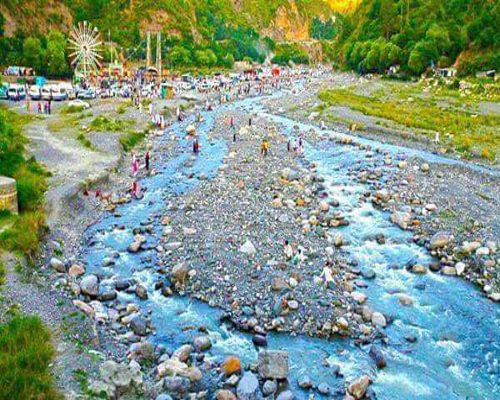

Location Name: Hernoi_Lake_Abbottabad



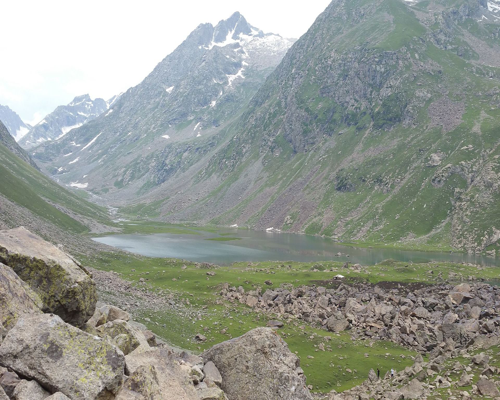

Location Name: IZMIS_Lake_Kalam_Valley



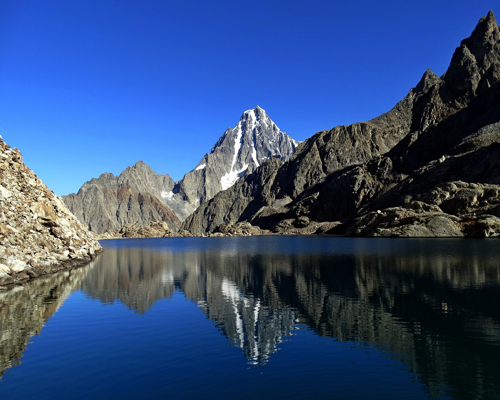

Location Name: Jabba_Zomalu_Lake



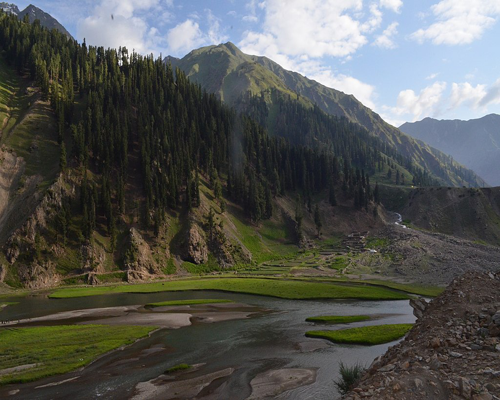

Location Name: Jhalkand,_Naran



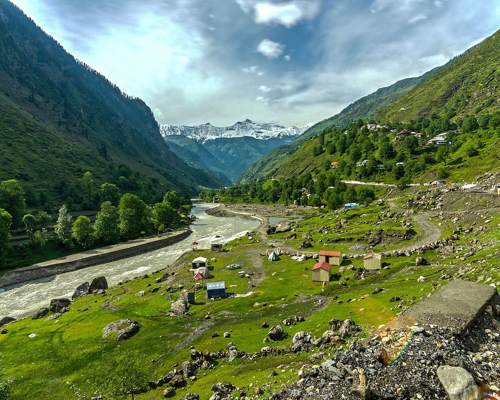

Location Name: Kaghan-valley



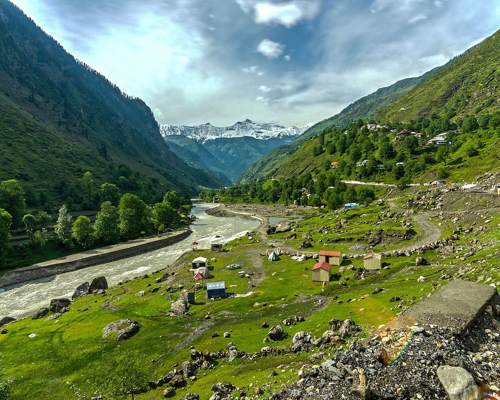

Location Name: Kaghan_Valley



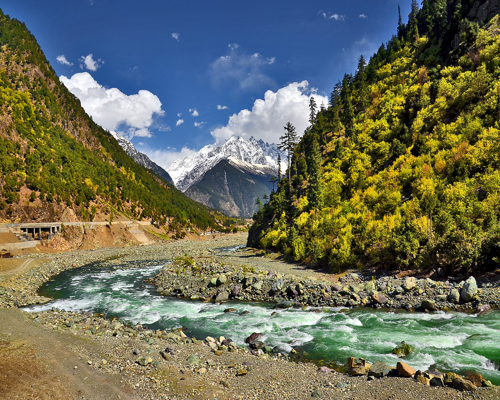

Location Name: Kalam-swat



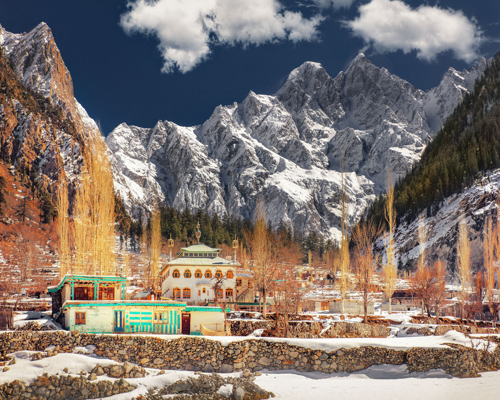

Location Name: Kalam_Matiltan



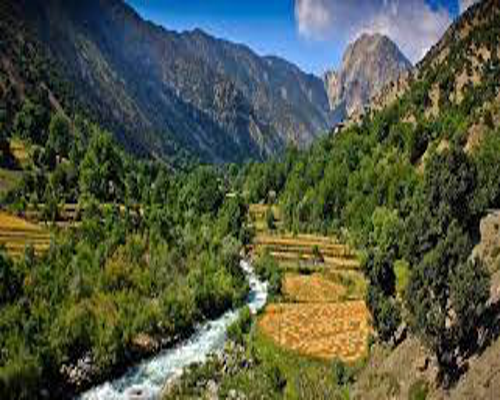

Location Name: Kalash_Valley_chitral



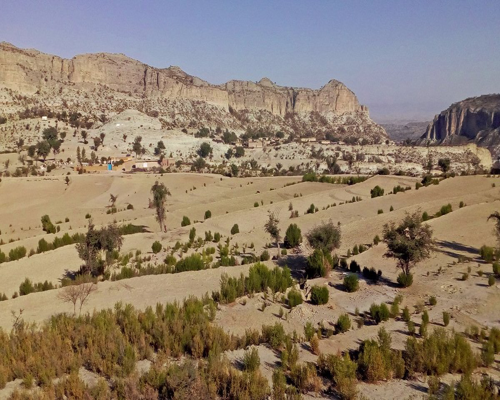

Location Name: Karak



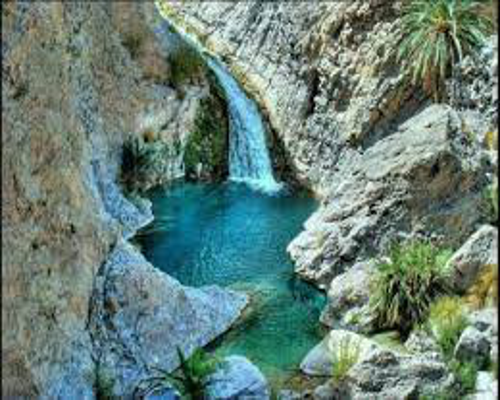

Location Name: Karlan_WaterFall_Abbotabad



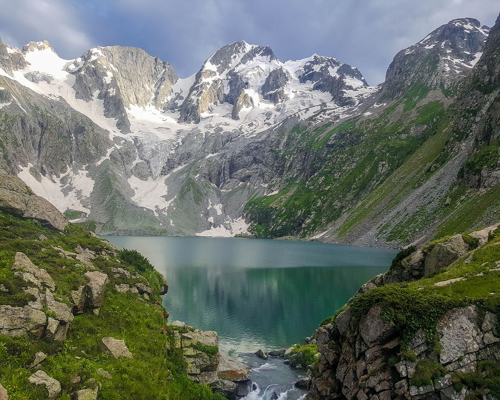

Location Name: Katora_lake_dir



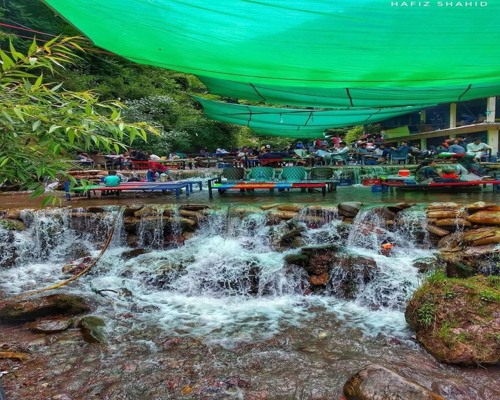

Location Name: Kawai_water_fall_Kaghan



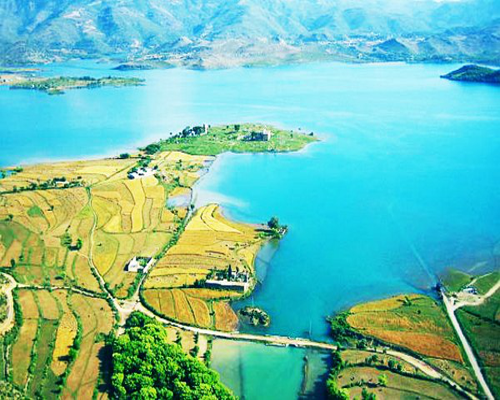

Location Name: khanpur-dam_Haripur



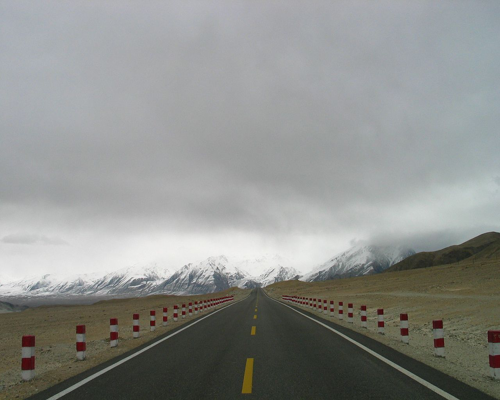

Location Name: Khunjerab_Pass



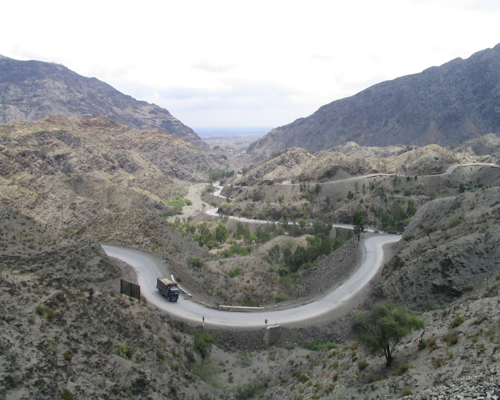

Location Name: KhyberPass



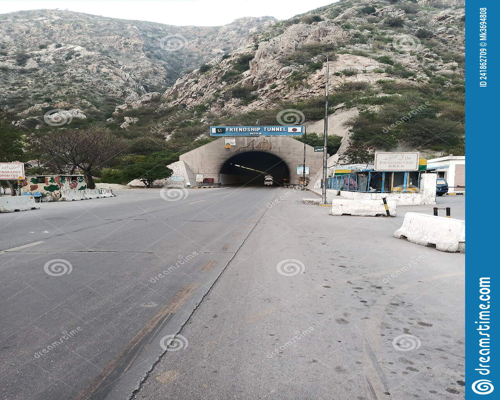

Location Name: Kohat



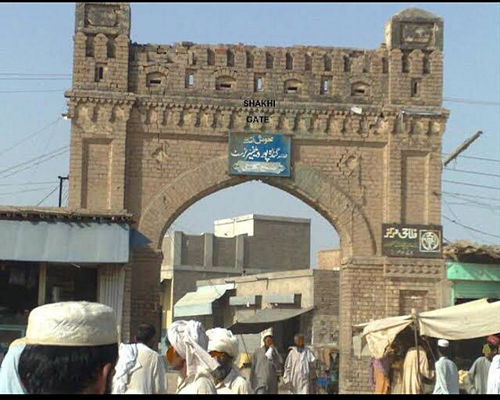

Location Name: Kulachi



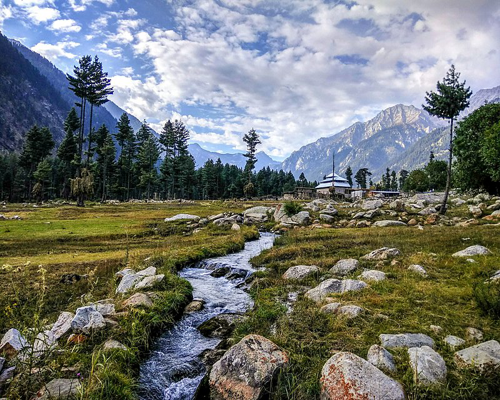

Location Name: KumratValley



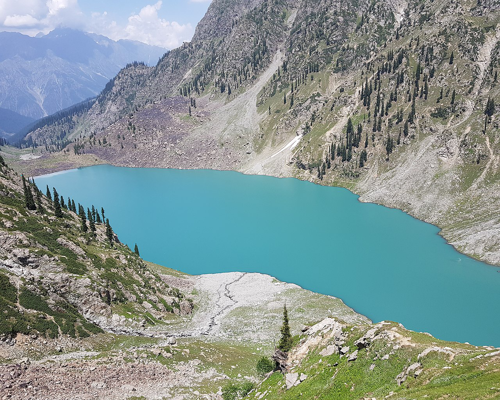

Location Name: Kundol_Lake_Utror_Valley



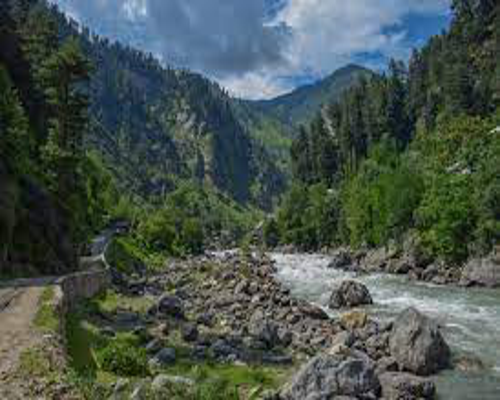

Location Name: Kunhar_River



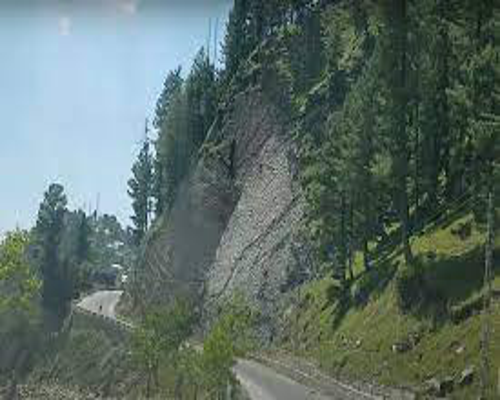

Location Name: Kuza_Gali_Abbottabad



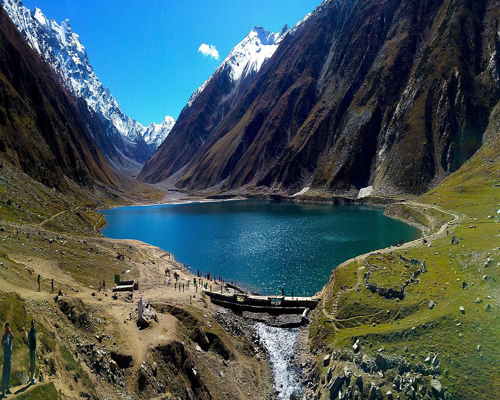

Location Name: Lake-Saiful-Malook



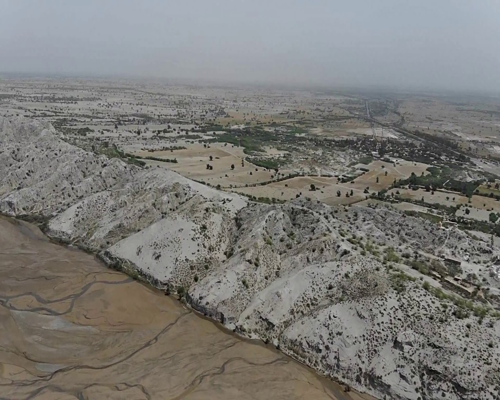

Location Name: Lakki



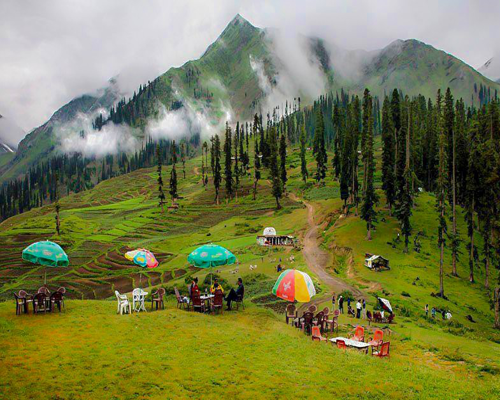

Location Name: Lalazar_Valley



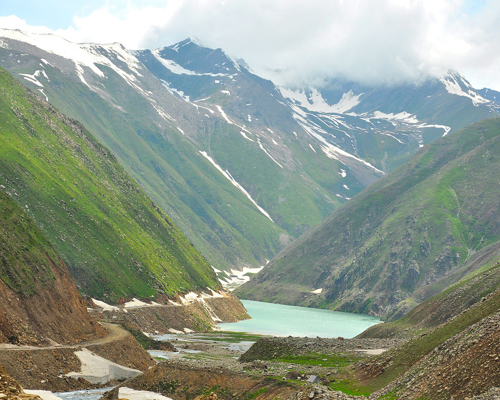

Location Name: Lulusar_Lake,_Naran,



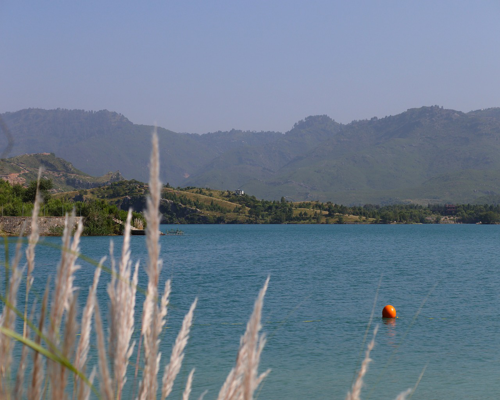

Location Name: Mabali-island-Khanpur



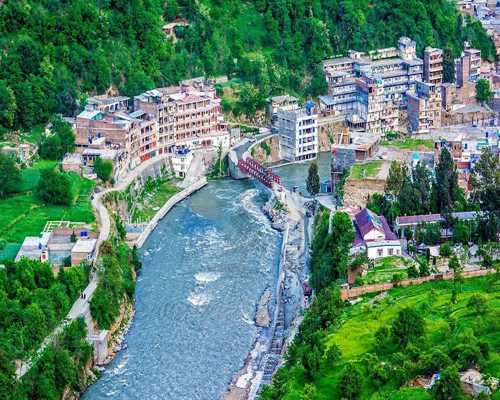

Location Name: Madyan-Swat



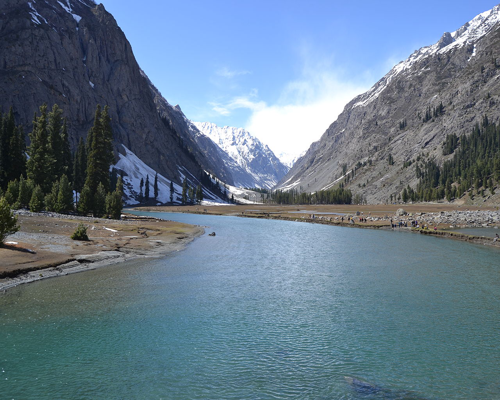

Location Name: Mahodand_Lake_in_Oshu_Valley



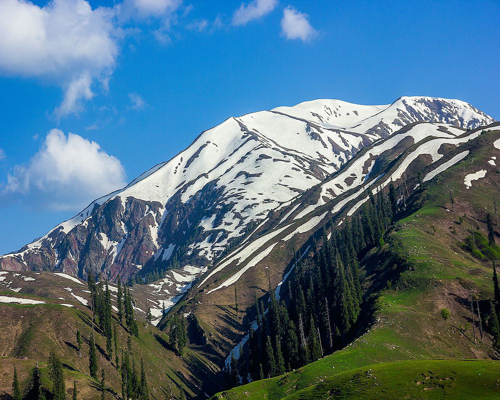

Location Name: Makra_Peak,_Shogran



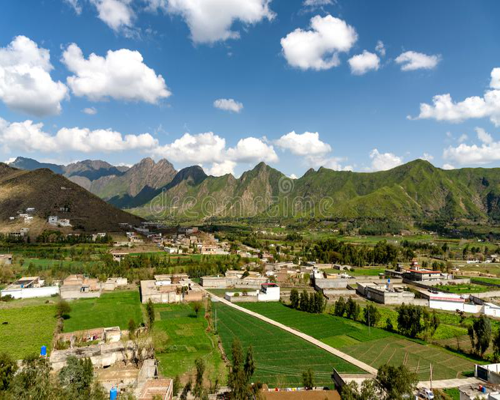

Location Name: Malakand



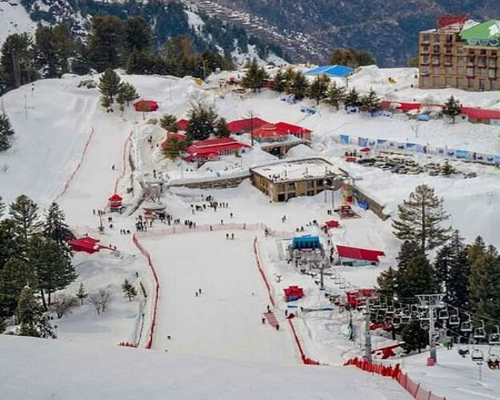

Location Name: Malamjabba-swat



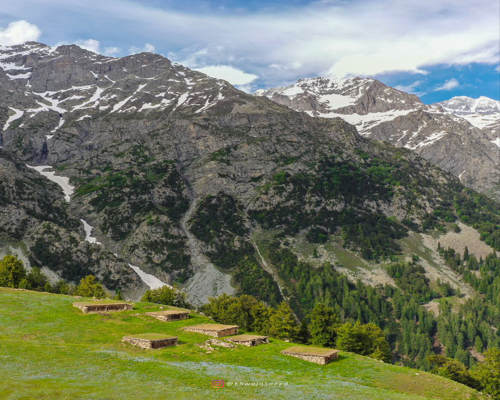

Location Name: Mankial_swat



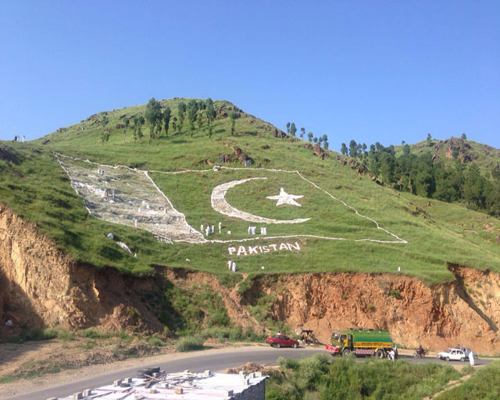

Location Name: Mansehra



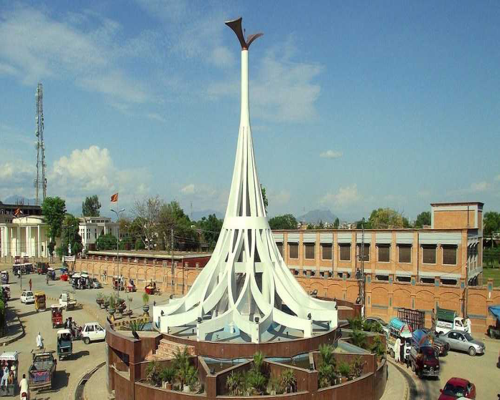

Location Name: Mardan



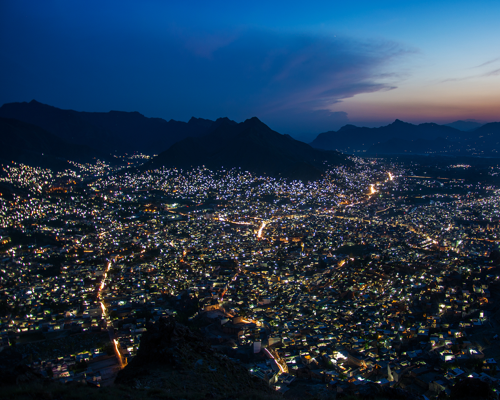

Location Name: Mingaora



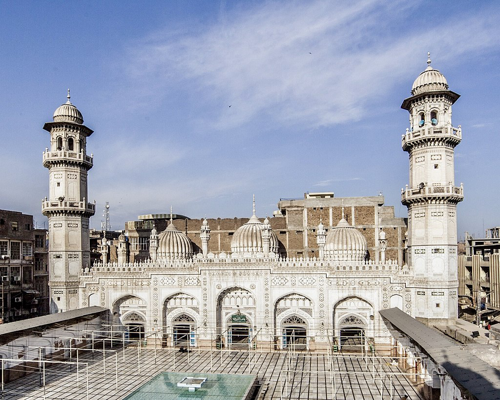

Location Name: MKmosque



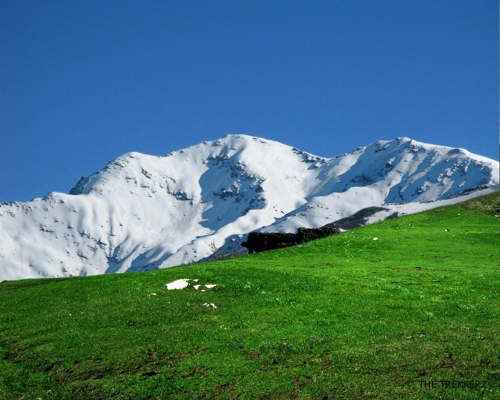

Location Name: Musa-Ka-Musalla



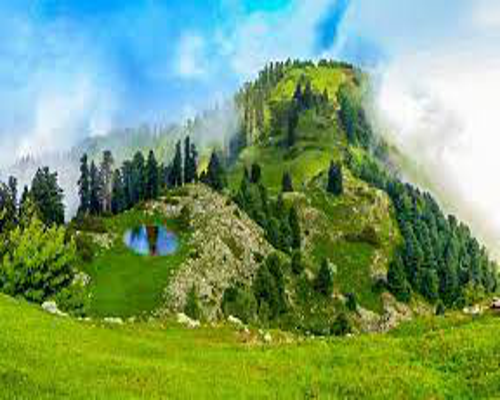

Location Name: Mushkpuri_Top



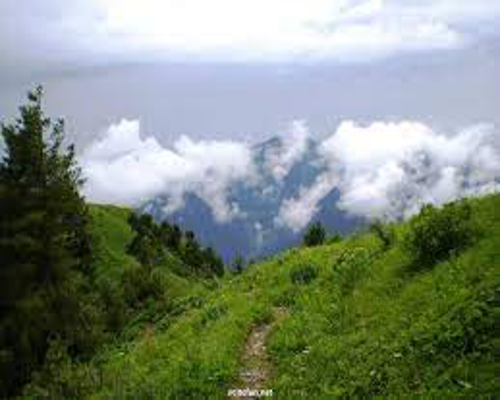

Location Name: Nathia_Gali



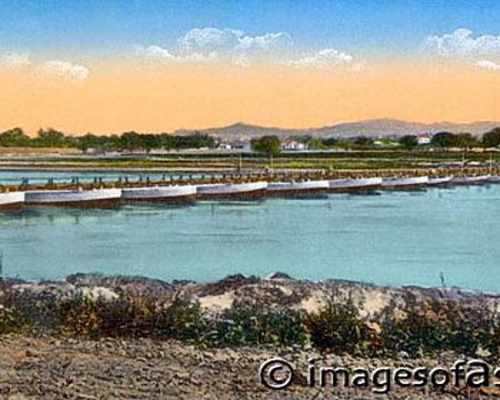

Location Name: Nowshera



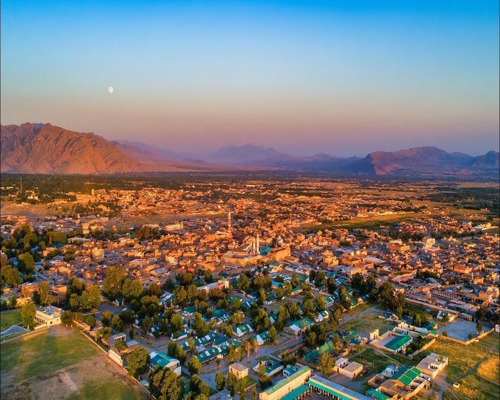

Location Name: Parachinar



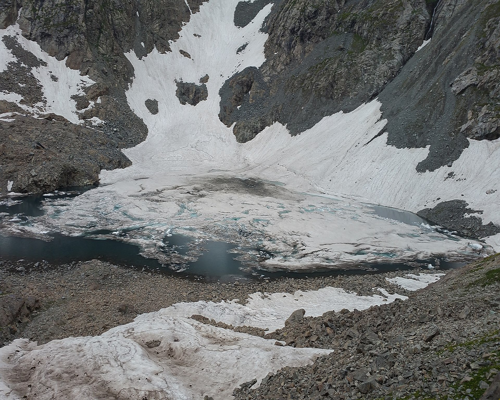

Location Name: Pari_Lake_Swat_Valley



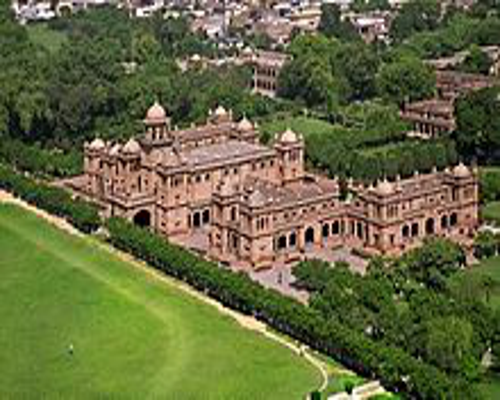

Location Name: Peshawar



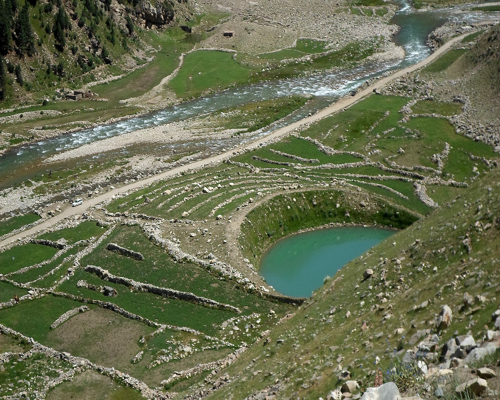

Location Name: Pyala_Lake,_Balakot_Tehsil



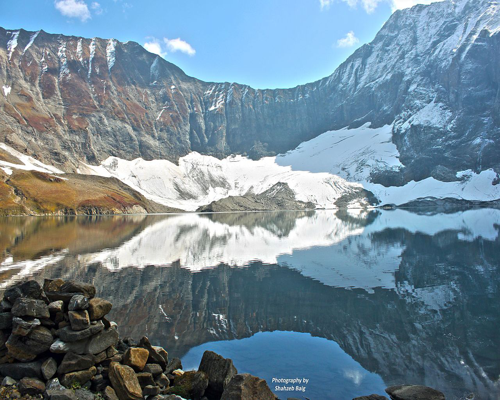

Location Name: Ratti_Gali_Lake



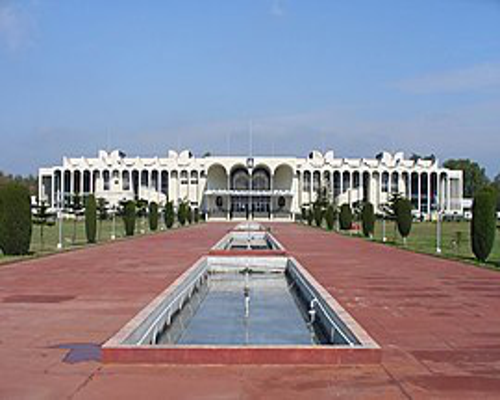

Location Name: Risalpur Cantonment



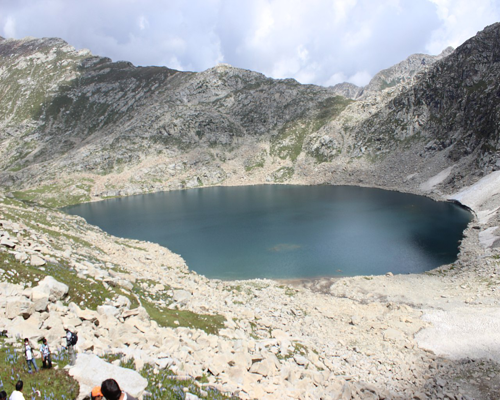

Location Name: Saidgai_Lake



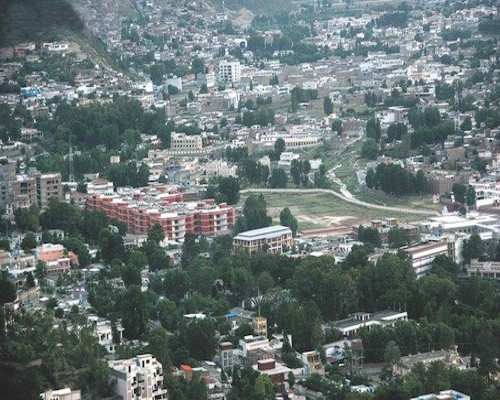

Location Name: Saidu-sharif



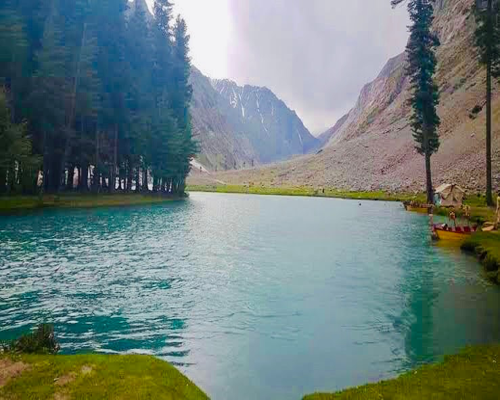

Location Name: saifullah-lake



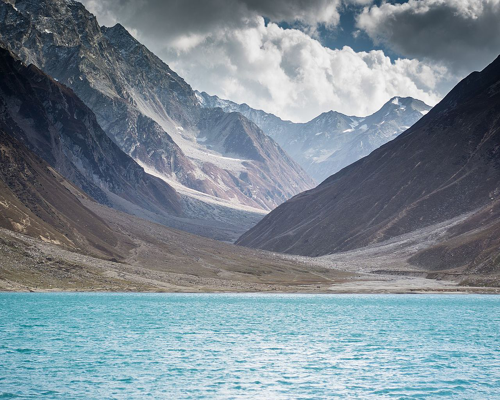

Location Name: Saif_ul_Malook_Lake_Naran



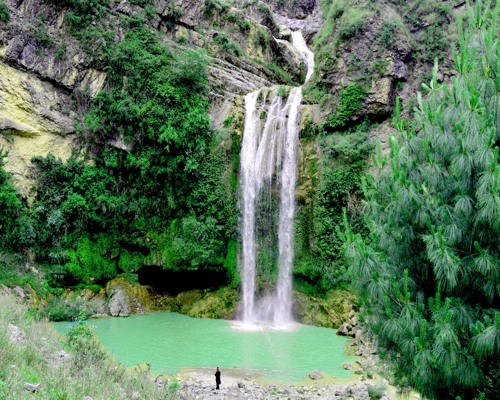

Location Name: Sajikot_Waterfall_Havelian



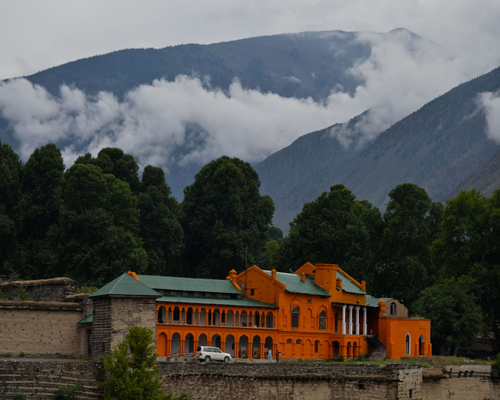

Location Name: Shahi_Fort_Chitral



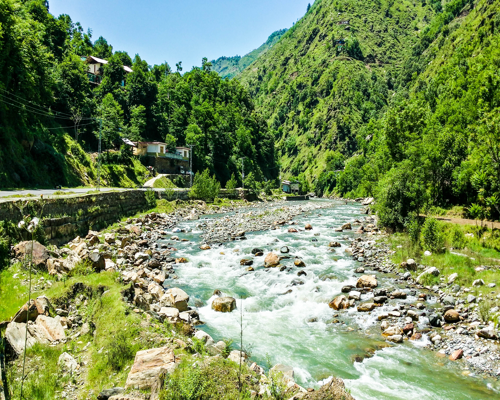

Location Name: Shangla_District



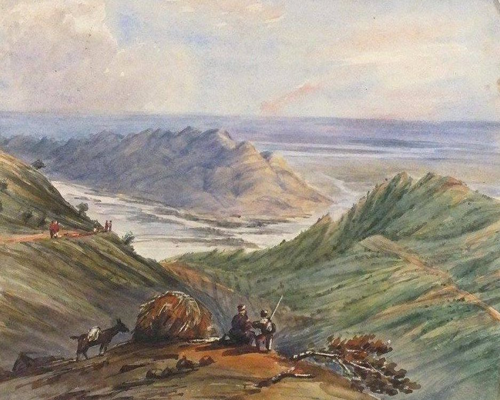

Location Name: Sheikh_Budeen



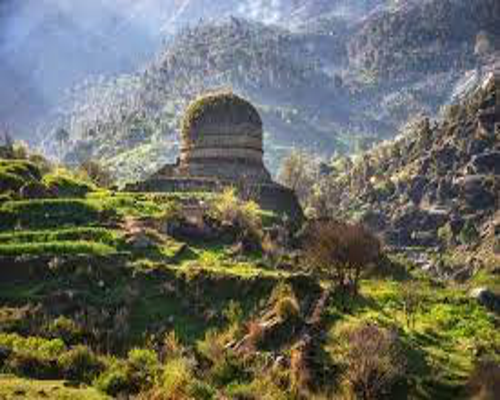

Location Name: Shingardar_stupa_swat



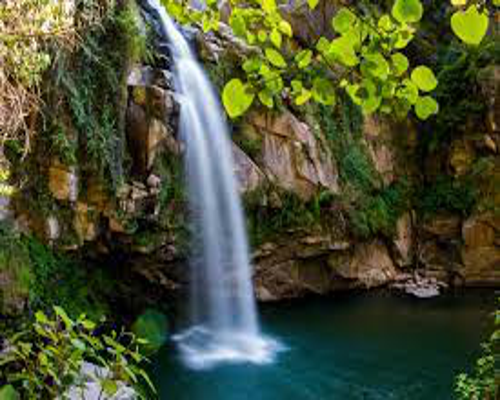

Location Name: shingrai_waterFall_Swat



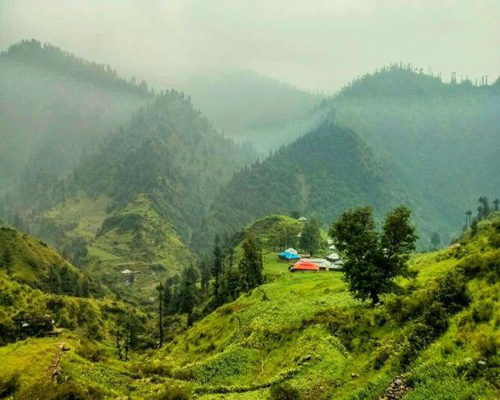

Location Name: Siren_Valley_Manshera



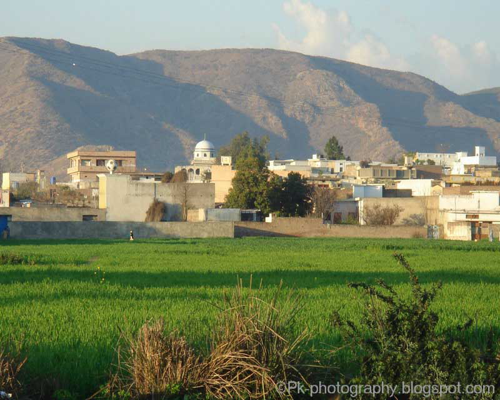

Location Name: Swabi



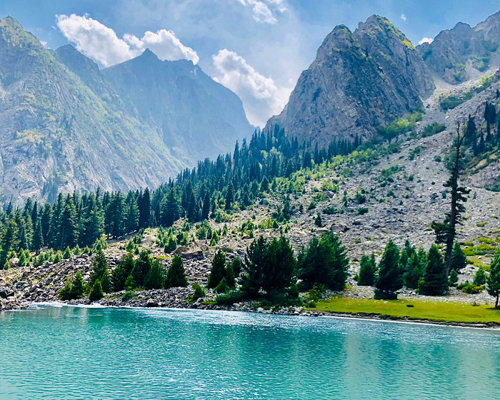

Location Name: Swat-valley



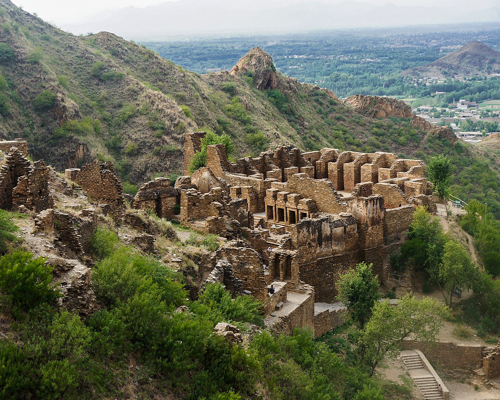

Location Name: Takht-e-bahi



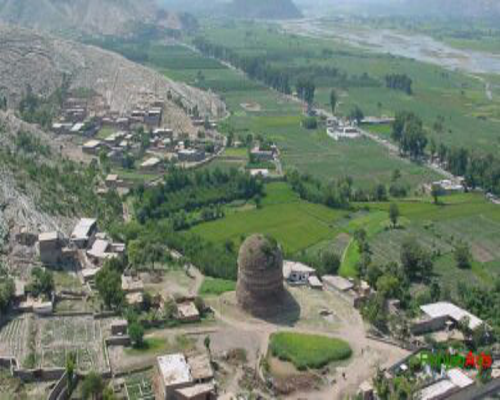

Location Name: Tank



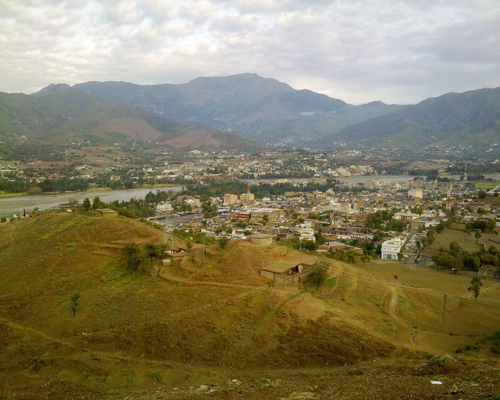

Location Name: Timargara



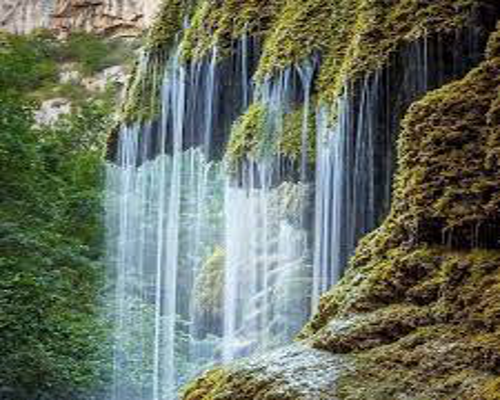

Location Name: Umbrella_Waterfall_Abbottabad



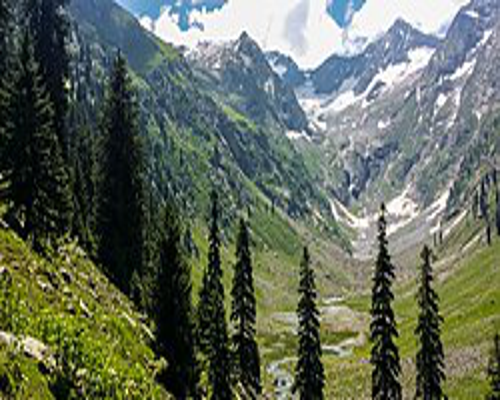

Location Name: Upper Dir



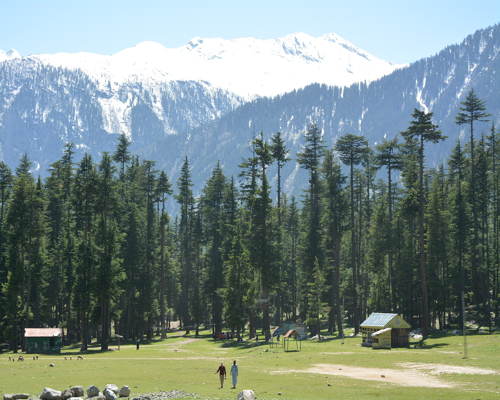

Location Name: Ushu_Forest,_Kalam



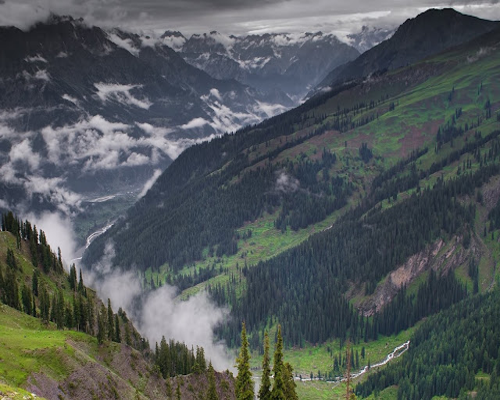

Location Name: Utror_Kalam_Swat_valley



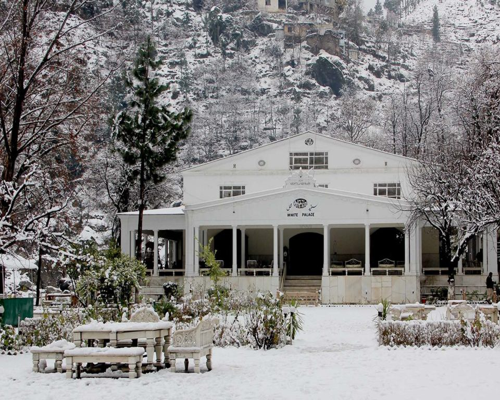

Location Name: White-Palace-Swat



In [52]:
from PIL import Image
from IPython.display import display
import glob
import os

# Folder path containing the images
# folder_path = 'C:/Users/hp/Desktop/zohaib/semester 8/FYP/location_images'
folder_path = './data/location_images'

# Set the desired width and height for the images
width = 500
height = 400

# Retrieve image files in the folder with the ".jpg" extension
image_files = glob.glob(os.path.join(folder_path, '*.jpg'))
print(image_files)
# Process each image file
for image_file in image_files:
    # Get the label name (filename without extension)
    label_name = os.path.splitext(os.path.basename(image_file))[0]
    
    # Open and resize the image
    image = Image.open(image_file)
    resized_image = image.resize((width, height))
    
    # Display the resized image
    display(resized_image)
    
    # Print the label name
    print("Location Name:", label_name)
    print()

# Word2Vec

## Training

In [53]:
from gensim.models.word2vec import Word2Vec

# Create model
word2vec_model = Word2Vec(min_count=0, workers = 8, vector_size=300) 
# Prepare vocab
word2vec_model.build_vocab(df.tok_lem_sentence.values)
# Train
word2vec_model.train(df.tok_lem_sentence.values, total_examples=word2vec_model.corpus_count, epochs=30)

(21355, 32070)

## Predict

In [56]:
def is_word_in_model(word, model):
    """
    Check on individual words ``word`` that it exists in ``model``.
    """
    assert type(model).__name__ == 'KeyedVectors'
    is_in_vocab = word in model.key_to_index.keys()
    return is_in_vocab

def predict_w2v(query_sentence, dataset, model, topk=3):
    query_sentence = query_sentence.split()
    in_vocab_list, best_index = [], [0]*topk
    for w in query_sentence:
        # remove unseen words from query sentence
        if is_word_in_model(w, model.wv):
            in_vocab_list.append(w)
    # Retrieve the similarity between two words as a distance
    if len(in_vocab_list) > 0:
        sim_mat = np.zeros(len(dataset))  # TO DO
        for i, data_sentence in enumerate(dataset):
            if data_sentence:
                sim_sentence = model.wv.n_similarity(
                        in_vocab_list, data_sentence)
            else:
                sim_sentence = 0
            sim_mat[i] = np.array(sim_sentence)
        # Take the five highest norm
        best_index = np.argsort(sim_mat)[::-1][:topk]
    return best_index

# Predict
best_index = predict_w2v(query_sentence, df['tok_lem_sentence'].values, word2vec_model)    
display(df[['city', 'sentence']].iloc[best_index])

,city,sentence
18,Chitral,"Chitral is known for its snowfall and deadly avalanches. The road that goes towards Chitral is very dangerous as it's one of the most narrow roads in the world, and it is situated in the world's largest mountain range"
13,Parachinar,"As this poplar trees was located right between the British established offices and the Kurram militia, and people from remote areas of the Kurram Valley often came and gathered here.Parachinar is very famous for its fresh fruits\r\n"
21,Malakand,"Particularly, the orange (malta) of Malakand is quite famous around Pakistan, is of export quality as well. Given the advent of CPEC in KP, it is high time that the horticulture of Malakand District is given a boost so that it can become a major “Fruit Supply Centre” to China and Central Asia.The famous Malakand Pass which connects Mardan to Swat and Dir is located near Dargai."


# Transformers 

In [ ]:
pip install sentence-transformers


## Load pretrained

In [ ]:
from sentence_transformers import SentenceTransformer, util

model = SentenceTransformer('paraphrase-MiniLM-L6-v2')
corpus_embeddings = model.encode(df.sentence.values, convert_to_tensor=True)
query_embedding = model.encode(query_sentence, convert_to_tensor=True)


## Predict

In [ ]:
import torch

# We use cosine-similarity and torch.topk to find the highest 3 scores
cos_scores = util.pytorch_cos_sim(query_embedding, corpus_embeddings)[0]
top_results = torch.topk(cos_scores, k=3)

print("\n\n======================\n\n")
print("Query:", query_sentence)
print("\nTop 5 most similar sentences in corpus:")

for score, idx in zip(top_results[0], top_results[1]):
    score = score.cpu().data.numpy() 
    idx = idx.cpu().data.numpy()
    display(df[['original_title', 'genres', 'sentence']].iloc[idx])  





Query: a crime story with a beautiful woman

Top 5 most similar sentences in corpus:


original_title                                                                                                                         Miss Bala
genres                                                                               [{'id': 18, 'name': 'Drama'}, {'id': 28, 'name': 'Action'}]
sentence          The story of a young woman clinging on to her dream to become a beauty contest queen in a Mexico dominated by organized crime.
Name: 18224, dtype: object

original_title                                                                                                                                                                                                                                                                                                                                 In the Cut
genres                                                                                                                                                                                                                                                                                  [{'id': 9648, 'name': 'Mystery'}, {'id': 53, 'name': 'Thriller'}]
sentence          Following the gruesome murder of a young woman in her neighborhood, a self-determined woman living in New York City--as if to test the limits of her own safety--propels herself into an impossibly risky sexual liaison. Soon she grows increasingly wary about the motives of every man with who

original_title                                                                                    The World of Suzie Wong
genres                                                    [{'id': 18, 'name': 'Drama'}, {'id': 10749, 'name': 'Romance'}]
sentence          Story of the love between a struggling American artist and a beautiful Chinese prostitute in Hong Kong.
Name: 8018, dtype: object

# BERT with hugging face
We write a class to load the dataset, embed it in the object and use is to compute distance with embed query sentence.

In [23]:
from sklearn.metrics.pairwise import cosine_similarity
from transformers import AutoTokenizer, AutoModel, pipeline
import torch
import numpy as np
from tqdm import tqdm


BERT_BATCH_SIZE = 4
MODEL_NAME = 'sentence-transformers/paraphrase-MiniLM-L6-v2'

class BertModel:
    def __init__(self, model_name, device=-1, small_memory=True, batch_size=BERT_BATCH_SIZE):
        self.model_name = model_name
        self._set_device(device)
        self.small_device = 'cpu' if small_memory else self.device
        self.batch_size = batch_size
        self.load_pretrained_model()

    def _set_device(self, device):
        if device == -1 or device == 'cpu':
            self.device = 'cpu'
        elif device == 'cuda' or device == 'gpu':
            self.device = 'cuda'
        elif isinstance(device, int) or isinstance(device, float):
            self.device = 'cuda'
        else:  # default
            self.device = torch.device(
                "cuda" if torch.cuda.is_available() else "cpu")

    def load_pretrained_model(self):
        self.tokenizer = AutoTokenizer.from_pretrained(self.model_name)
        self.model = AutoModel.from_pretrained(self.model_name)
        device = -1 if self.device == 'cpu' else 0
        self.pipeline = pipeline('feature-extraction',
                                 model=self.model, tokenizer=self.tokenizer, device=device)

    def embed(self, data):
        """ Create the embedded matrice from original sentences """
        nb_batchs = 1 if (len(data) < self.batch_size) else len(
            data) // self.batch_size
        batchs = np.array_split(data, nb_batchs)
        mean_pooled = []
        for batch in tqdm(batchs, total=len(batchs), desc='Training...'):
            mean_pooled.append(self.transform(batch))
        mean_pooled_tensor = torch.tensor(
            len(data), dtype=float).to(self.small_device)
        mean_pooled = torch.cat(mean_pooled, out=mean_pooled_tensor)
        self.embed_mat = mean_pooled

    @staticmethod
    def mean_pooling(model_output, attention_mask):
        token_embeddings = model_output[0]
        input_mask_expanded = attention_mask.unsqueeze(
            -1).expand(token_embeddings.size()).float()
        return torch.sum(token_embeddings * input_mask_expanded, 1) / torch.clamp(input_mask_expanded.sum(1), min=1e-9)

    def transform(self, data):
        if 'str' in data.__class__.__name__:
            data = [data]
        data = list(data)
        token_dict = self.tokenizer(
            data,
            padding=True,
            truncation=True,
            max_length=512,
            return_tensors="pt")
        token_dict = self.to(token_dict, self.device)
        with torch.no_grad():
            token_embed = self.model(**token_dict)
        # each of the 512 token has a 768 or 384-d vector depends on model)
        attention_mask = token_dict['attention_mask']
        # average pooling of masked embeddings
        mean_pooled = self.mean_pooling(
            token_embed, attention_mask)
        mean_pooled = mean_pooled.to(self.small_device)
        return mean_pooled
    
    def to(self, data: dict, device: str):
        """Send all values to device by calling v.to(device)"""
        data = {k: v.to(device) for k, v in data.items()}
        return data

    def predict(self, in_sentence, topk=3):
        input_vec = self.transform(in_sentence)
        mat = cosine_similarity(input_vec, self.embed_mat)
        # best cos sim for each token independantly
        best_index = extract_best_indices(mat, topk=topk)
        return best_index

## Training

In [24]:
# CPU training
bert_model = BertModel(model_name=MODEL_NAME, batch_size=BERT_BATCH_SIZE)
bert_model.embed(df.sentence.values)

Training...: 100%|██████████| 722/722 [16:36<00:00,  1.38s/it]
<ipython-input-23-a36cfc666a77>:47: UserWarning: An output with one or more elements was resized since it had shape [], which does not match the required output shape [2890, 384]. This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at ../aten/src/ATen/native/Resize.cpp:17.)
  mean_pooled = torch.cat(mean_pooled, out=mean_pooled_tensor)


In [ ]:
# GPU training
bert_model_gpu = BertModel(model_name=MODEL_NAME, batch_size=BERT_BATCH_SIZE, device='cuda')
bert_model_gpu.transform(df.sentence.values)

## Prediction

In [26]:
query_sentence = 'often snowfall beautiful mountains'
indices = bert_model.predict(query_sentence)
display(df[['city', 'sentence']].iloc[indices])


,ID.1,City,sentence
2489,2490,Rome,"Leave behind the chaos of the city and take a serene walk through the snowy landscape of the Monti Simbruini mountain range. This hike will take you through beautiful beech forest where I will help you to look for animal prints in the fresh snow, or you can simply just enjoy the breathtaking surroundings of the mountain before stopping off at a traditional cabin where hot drinks will be served.\n\nMy other Airbnb Experiences\n\nSunset Hike in a Nature Reserve\nwww.airbnb.com/sunsethike\n\nS..."
1550,1551,Oslo,"-Escape the crowds. \n-Perfect for beginners, easier than you believe.\n-Nice warm lunch/dinner.\n-One minute after exiting the bus, you have skis on your feet.\n-Best chance for sun - tour from 10 to 2 o'clock.\n-Ski, snow, ice and fire. This is Norway.\nYou will be surprised how 'Alaska' the area looks like, so close to the center (25 minutes bus south, from the Opera) We will ski over a frozen lake (totally safe) and into the Wilderness. After some skiing we will make a fire, and enjoy a ..."
450,451,Athens,"Expansive views, towering trees, and dramatic geology are just some of the astounding features of this tour in Atticas largest national park.\n\nAncient Greeks believed that the cloven-hoof god Pan used to come here to play his flute and dance in the forest!\n\nWe start our journey by picking up from a main metro station. Sit back and relax the 40m driving to the mountains.\n\nOur trekking adventure begins from a gorgeous canyon. Be ready to jump over small rivers, scramble on rocks, bend un..."
